In [1]:
import os
import numpy as np

import trimesh

import scipy.ndimage as ndimage
import skimage.morphology as morphology

import networkx as nx
from sklearn.neighbors import NearestNeighbors

from splipy import curve_factory

%matplotlib widget
import matplotlib.pyplot as plt
from matplotlib.widgets import CheckButtons, Slider

## Data

Load triangle mesh

In [2]:
# Surface Mesh
mesh = trimesh.load_mesh(file_obj="11d.obj", file_type="obj")

Get binary images (surface + filled)

In [3]:
def binary_to_coordinates(binary:np.ndarray):

    ''' Get coordinates of pixels ("1" values) from 3D binary image
    
    Parameters
    ----------
    binary : numpy.NDArray
        3D binary image
    
    Returns
    -------
    x, y, z : numpy.NDArray
        x, y, and z coordinates of pixels, where the origin is (0,0,0)
    '''

    # get "1" values
    coords = np.array(np.where(binary == 1))

    # split
    x = coords[0,:]
    y = coords[1,:]
    z = coords[2,:]

    return x, y, z

In [4]:
# Filled Binary Image
image = mesh.voxelized(1).fill().matrix.astype(int)
X, Y, Z = binary_to_coordinates(image)

In [5]:
# Surface Binary Image
surface = mesh.voxelized(1).hollow().matrix.astype(int)
XS, YS, ZS = binary_to_coordinates(surface)

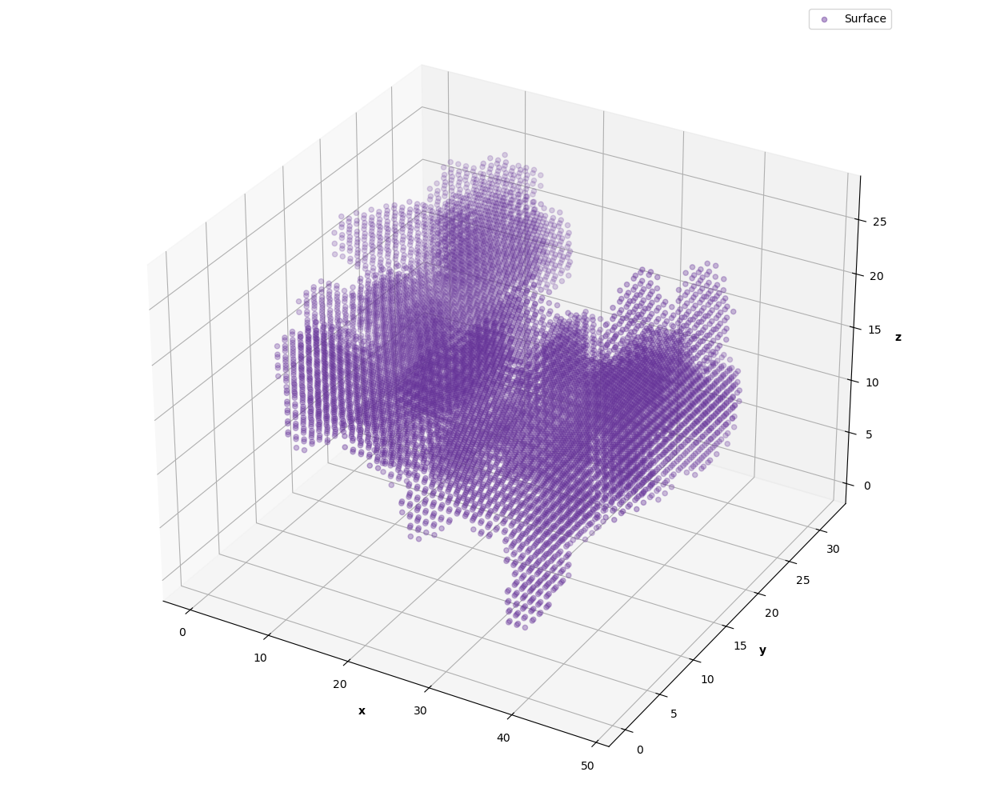

In [6]:
# Visualize Filled Binary Image
plt.close()

# figure
fig = plt.figure(figsize=(12.5, 10), layout="constrained")
ax = fig.add_subplot(111, projection="3d")

# plot
ax.scatter(X, Y, Z, c=("rebeccapurple", 0.45), label="Surface")

# labels
ax.set_xlabel("x", weight="bold")
ax.set_ylabel("y", weight="bold")
ax.set_zlabel("z", weight="bold")

ax.legend()

# save
fig.savefig("figures/binary_image.svg", transparent=True)

## Space Curve Derivation 

Find the space curve that best represents the shape

### Morphology

In [7]:
def best_path(skeleton:np.ndarray) -> tuple[np.ndarray, np.ndarray, np.ndarray]:

    ''' Find the best path between skeleton points
    
    Parameters
    ----------
    skeleton : numpy.NDArray
        binary image of skeleton points
    
    Returns
    -------
    x, y, z : numpy.NDArray
        ordered x, y, and z coordinates of skeleton points
    '''

    # get skeleton points
    x, y, z = binary_to_coordinates(skeleton)
    pts = np.c_[x, y, z]

    # neighbors and graphs
    nn = NearestNeighbors(n_neighbors=2).fit(pts)
    g = nx.from_scipy_sparse_array(nn.kneighbors_graph(mode="distance"))

    # shortest path for each start point
    paths = [list(nx.dfs_preorder_nodes(g, i)) for i in range(len(pts))]

    # get lowest cost path
    dist = np.inf
    idx = 0

    # for each shortest path:
    for i in range(len(pts)):
        p = paths[i]
        ordered = pts[p]
        cost = (((ordered[:-1] - ordered[1:])**2).sum(1)).sum()

        # better path
        if cost < dist:
            dist = cost
            idx = i

    # get best path
    order = paths[idx]

    # sort vertices
    x = x[order]
    y = y[order]
    z = z[order]

    return x, y, z

In [8]:
def visualize_morphology(morph:np.ndarray, morph_label:str, alpha_ori:float, alpha_morph:float, name:str):

    ''' Plot results of morphological operations against the original surface
    
    Parameters
    ----------
    morph : numpy.NDArray
        binary image array from morphological orperation
    morph_label : numpy.NDArray
        label for morph binary image array
    alpha_ori, alpha_morph : float
        alpha values of original binary image surface
    name : str
        name of .png file to which to save plot
    '''

    # coordinates
    x, y, z = binary_to_coordinates(morph)
    
    plt.close()

    # figure
    fig = plt.figure(figsize=(12.5, 10), layout="constrained")
    ax = fig.add_subplot(111, projection="3d")

    # plot
    ax.scatter(XS, YS, ZS, c=("tab:blue", alpha_ori), label="Surface")
    ax.scatter(x, y, z, c="red", alpha=alpha_morph, label=morph_label)

    # labels
    ax.set_xlabel("x", weight="bold")
    ax.set_ylabel("y", weight="bold")
    ax.set_zlabel("z", weight="bold")

    ax.legend()
    
    # save
    os.makedirs("figures/morphology", exist_ok=True)
    fig.savefig(f"figures/morphology/{name}.svg", transparent=True)

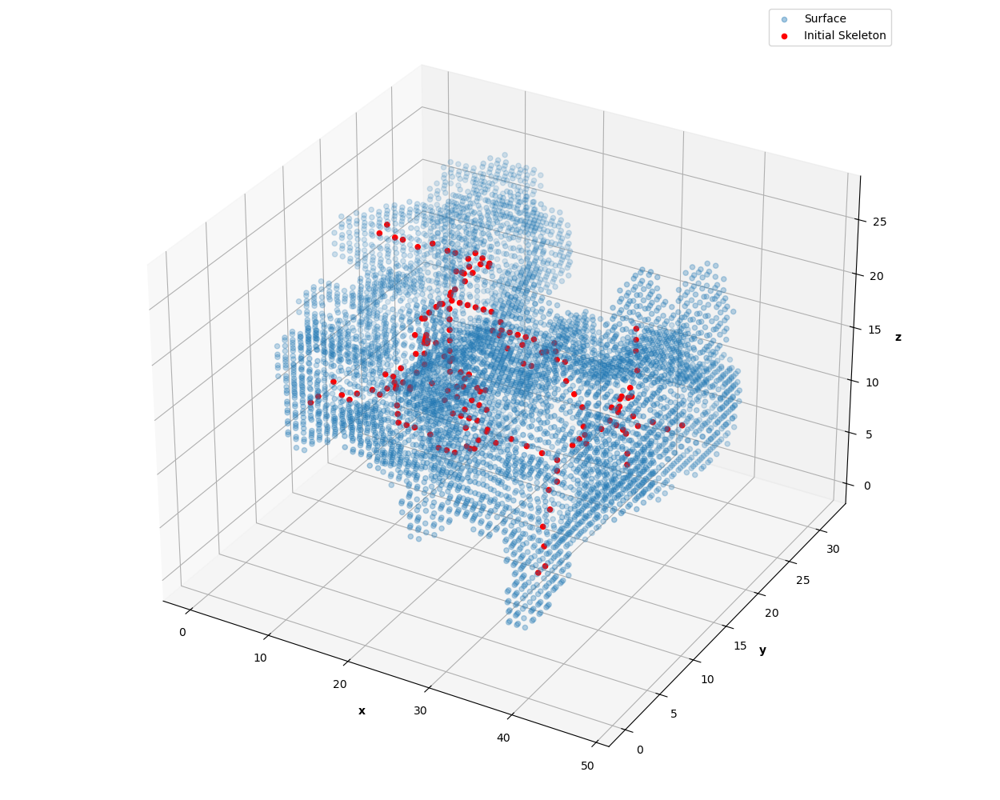

In [9]:
# Initial Skeletonization

# skeletonize
skeleton = morphology.skeletonize(image)
visualize_morphology(skeleton, "Initial Skeleton", 0.4, 1, "initial_skeleton")

xP, yP, zP = best_path(skeleton)

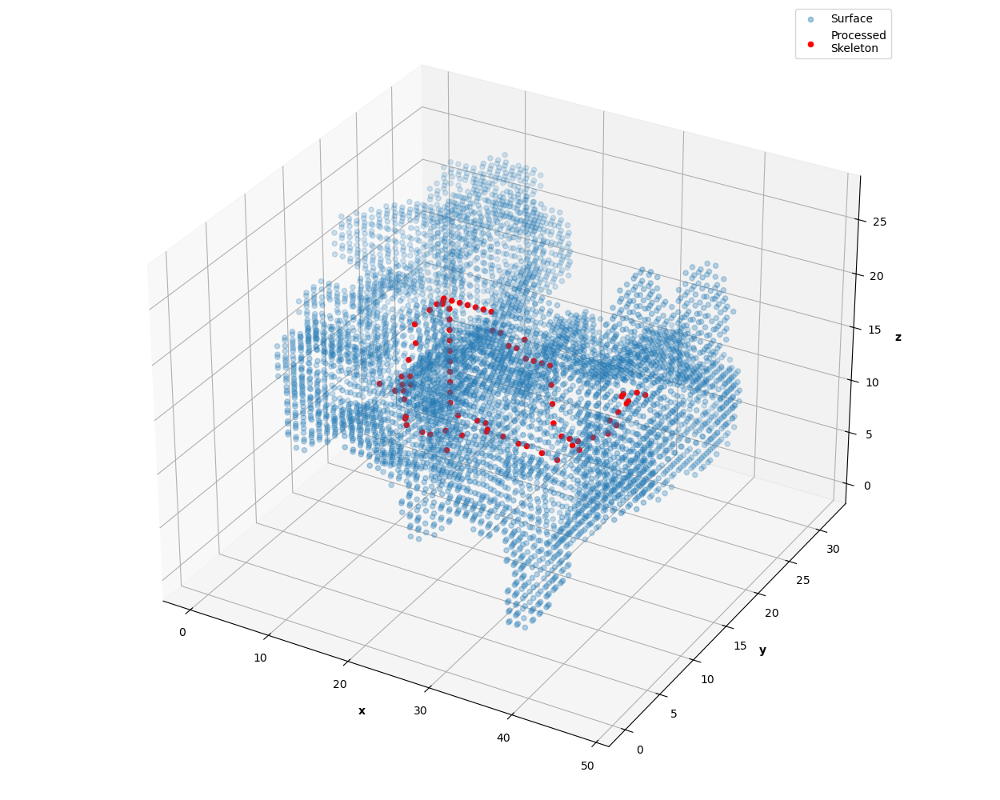

In [10]:
# Binary Opening + Skeletonization

# binary opening
skeleton = ndimage.binary_opening(image, iterations=3).astype(int)
visualize_morphology(skeleton, "Post-Binary\nOpening", 0.55, 0.35, "binary_opening")

# skeletonize
skeleton = morphology.skeletonize(skeleton)
visualize_morphology(skeleton, "Processed\nSkeleton", 0.4, 1, "skeleton_points")

# shortest path between skeleton points
xP, yP, zP = best_path(skeleton)

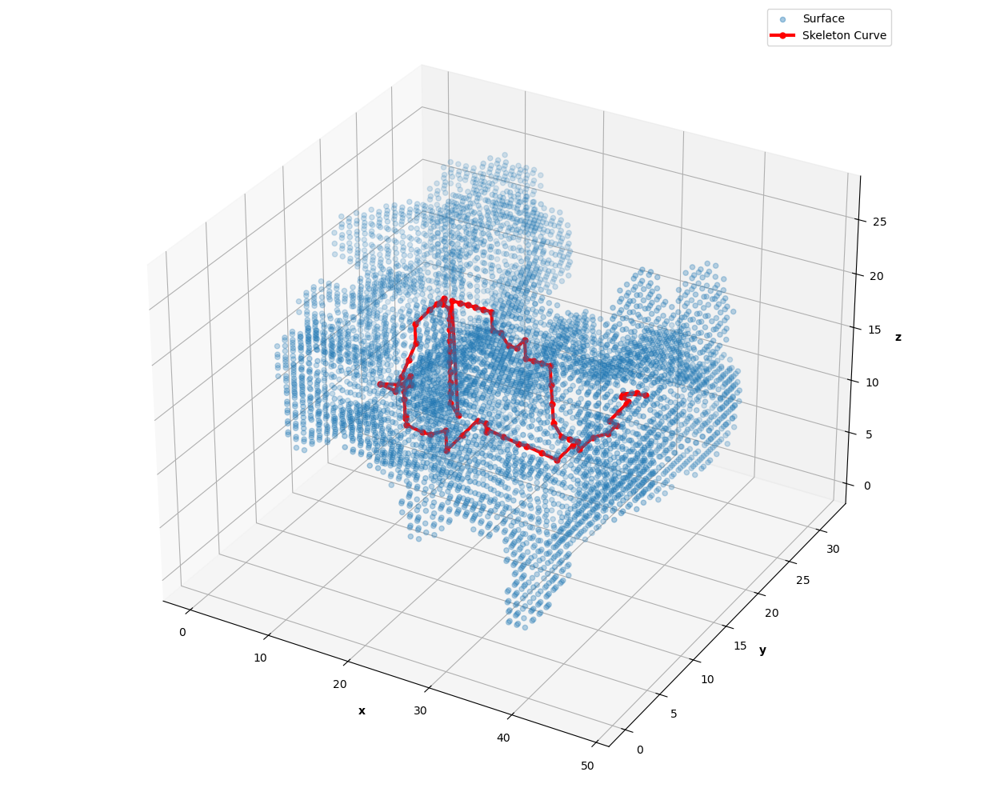

In [11]:
# Visualize Skeleton Space Curve
plt.close()

# figure
fig = plt.figure(figsize=(12.5, 10), layout="constrained")
ax = fig.add_subplot(111, projection="3d")

# plot
ax.scatter(XS, YS, ZS, c=("tab:blue", 0.4), label="Surface")
ax.plot(xP, yP, zP, color="red", ls="-", lw=3, marker=".", ms=10, label="Skeleton Curve")

# labels
ax.set_xlabel("x", weight="bold")
ax.set_ylabel("y", weight="bold")
ax.set_zlabel("z", weight="bold")

ax.legend()

# save
os.makedirs("figures/morphology", exist_ok=True)
fig.savefig("figures/morphology/skeleton_space_curve.svg", transparent=True)

### Curve

In [ ]:
# Define Curve

# cubic spline interpolation
control = np.concatenate((xP.reshape(-1,1), yP.reshape(-1,1), zP.reshape(-1,1)), axis=1)
curve = curve_factory.cubic_curve(control)

# parameter limits
u0 = curve.start()[0]
u1 = curve.end()[0]

# get sample points
u = np.linspace(curve.start()[0], curve.end()[0], 1000)
pts = curve.evaluate(u)
xC, yC, zC = pts[:,0], pts[:,1], pts[:,2]

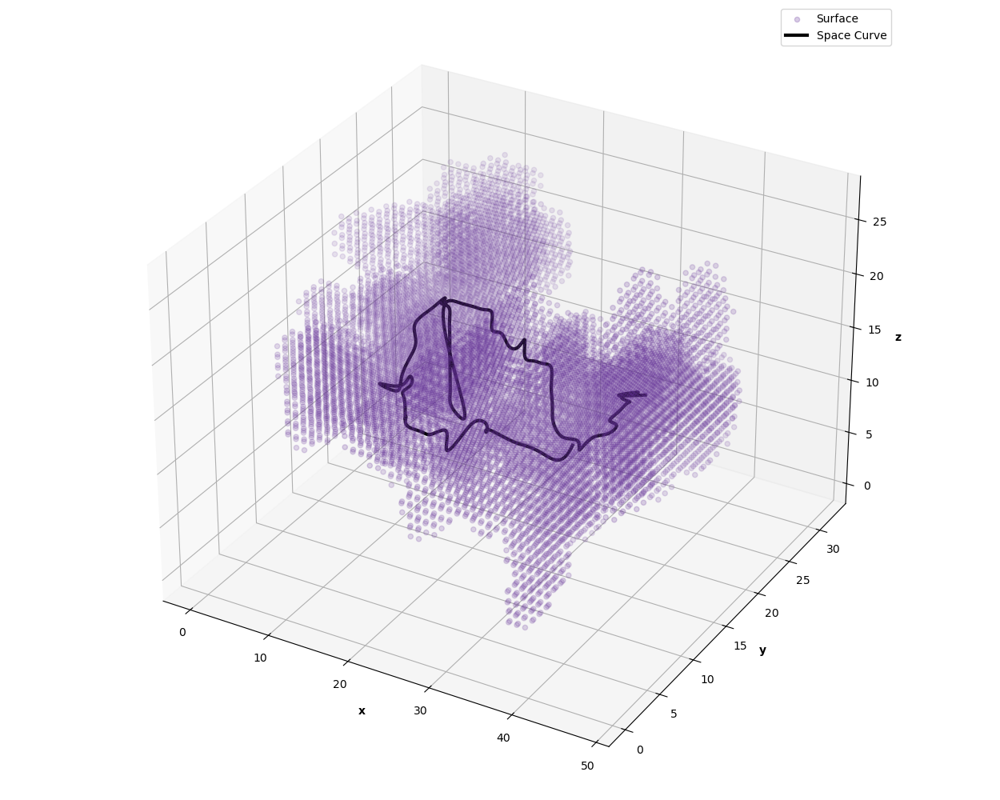

In [13]:
# Visualize Curve
plt.close()

# figure
fig = plt.figure(figsize=(12.5, 10), layout="constrained")
ax = fig.add_subplot(111, projection="3d")

# plot
ax.scatter(X, Y, Z, c=("rebeccapurple", 0.25), label="Surface")
ax.plot(xC, yC, zC, c="black", lw=3, label="Space Curve")

# labels
ax.set_xlabel("x", weight="bold")
ax.set_ylabel("y", weight="bold")
ax.set_zlabel("z", weight="bold")

ax.legend()

# save
fig.savefig("figures/morphology/parameterized_space_curve.svg", transparent=True)

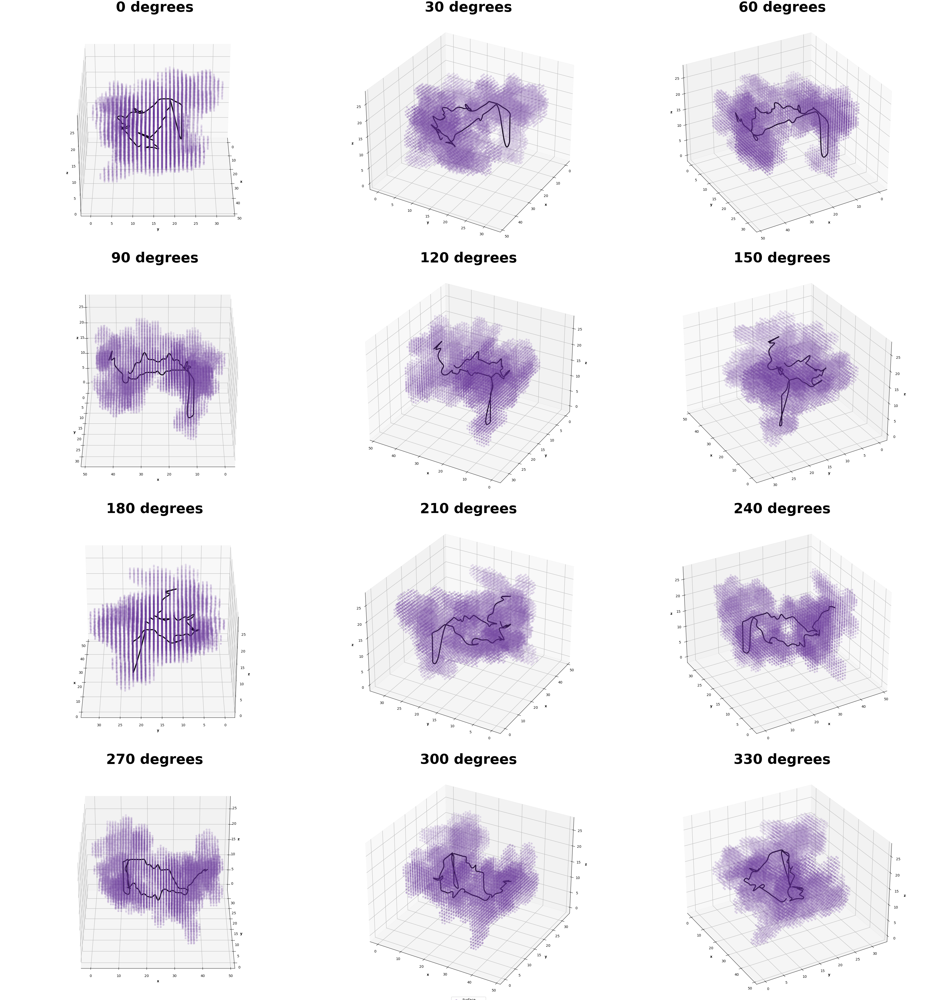

In [14]:
# Show different view angles
plt.close()

# figure
fig = plt.figure(figsize=(37.5, 40), layout="constrained")

for i,a in enumerate(range(0, 360, 30)):
    ax = fig.add_subplot(4, 3, i+1, projection="3d", azim=a)

    # plot
    s = ax.scatter(X, Y, Z, c=("rebeccapurple", 0.25), label="Surface")
    c, = ax.plot(xC, yC, zC, c="black", lw=3, label="Space Curve")

    # labels
    ax.set_title(f"{a} degrees", weight="bold", size=40)
    ax.set_xlabel("x", weight="bold")
    ax.set_ylabel("y", weight="bold")
    ax.set_zlabel("z", weight="bold")

# legend
fig.legend(handles=[s,c], loc=8, bbox_to_anchor=(0.5, -0.01))

# save
fig.savefig("figures/space_curve_view_angles.svg", transparent=True, bbox_inches="tight")
fig.savefig("figures/space_curve_view_angles.png", transparent=True, bbox_inches="tight")